<a href="https://colab.research.google.com/github/av79/MyDataScienceJourney/blob/main/Aditi_Exploratory_data_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Functional Code to accelarate the EDA process for any Demand Forecasting 

In [ ]:
import pickle
import xarray as xr
import numpy as np
# pyplot needed to plot the dataset, but animation only needed much further down.
from matplotlib import pyplot as plt, animation
%matplotlib inline

# This is needed to display graphics calculated outside of jupyter notebook
from IPython.display import HTML, display

try:
    import holoviews as hv
    from holoviews import opts
except:
    !pip install holoviews
    print('Stopping RUNTIME. Please run again.')
    exit()

In [ ]:
from google.colab import files

uploaded = files.upload()

for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))

Saving sales.p to sales (5).p
User uploaded file "sales.p" with length 195507 bytes


In [ ]:
with open("sales.p", "rb") as file:
    I_data = pickle.load(file)

#I_data = I_data.max('iphone')

I_data

<xarray.DataArray (Clients: 9, Date: 292, Product: 9)>
array([[[  640.,   286.,     0., ...,     0.,     0.,     0.],
        [  563.,   394.,     0., ...,     0.,     0.,     0.],
        [  637.,   434.,     0., ...,     0.,     0.,     0.],
        ...,
        [    0.,     0.,   417., ...,     0.,     0.,   557.],
        [    0.,     0.,   481., ...,     0.,   136.,   818.],
        [    0.,     0.,   190., ...,     0.,    80.,   293.]],

       [[  121.,   121.,   121., ...,   121.,   121.,   121.],
        [  970.,   970.,   970., ...,   970.,   970.,   970.],
        [ 1180.,  1180.,  1180., ...,  1180.,  1180.,  1180.],
        ...,
        [ 5071.,  5071.,  5071., ...,  5071.,  5071.,  5071.],
        [ 6608.,  6608.,  6608., ...,  6608.,  6608.,  6608.],
        [ 2676.,  2676.,  2676., ...,  2676.,  2676.,  2676.]],

       [[ 2606.,  2606.,  2606., ...,  2606.,  2606.,  2606.],
        [ 1929.,  1929.,  1929., ...,  1929.,  1929.,  1929.],
        [  997.,   997.,   997., ...,   997.,   997.,   997.],
        ...,
        [ 7624.,  7624.,  7624., ...,  7624.,  7624.,  7624.],
        [11389., 11389., 11389., ..., 11389., 11389., 11389.],
        [ 4206.,  4206.,  4206., ...,  4206.,  4206.,  4206.]],

       ...,

       [[    0.,     0.,     0., ...,     0.,     0.,     0.],
        [    0.,     0.,     0., ...,     0.,     0.,     0.],
        [    0.,     0.,     0., ...,     0.,     0.,     0.],
        ...,
        [    0.,     0.,     0., ...,     0.,     0.,     0.],
        [    0.,     0.,     0., ...,     0.,     0.,     0.],
        [    0.,     0.,     0., ...,     0.,     0.,     0.]],

       [[    0.,     0.,     0., ...,     0.,     0.,     0.],
        [    0.,     0.,     0., ...,     0.,     0.,     0.],
        [    0.,     0.,     0., ...,     0.,     0.,     0.],
        ...,
        [ 2832.,  2832.,  2832., ...,  2832.,  2832.,  2832.],
        [ 3345.,  3345.,  3345., ...,  3345.,  3345.,  3345.],
        [  936.,   936.,   936., ...,   936.,   936.,   936.]],

       [[    0.,     0.,     0., ...,     0.,     0.,     0.],
        [    0.,     0.,     0., ...,     0.,     0.,     0.],
        [    0.,     0.,     0., ...,     0.,     0.,     0.],
        ...,
        [ 1013.,  1013.,  1013., ...,  1013.,  1013.,  1013.],
        [ 1997.,  1997.,  1997., ...,  1997.,  1997.,  1997.],
        [ 1378.,  1378.,  1378., ...,  1378.,  1378.,  1378.]]])
Coordinates:
  * Date     (Date) datetime64[ns] 2014-09-28 2014-10-05 ... 2020-04-26
  * Product  (Product) object 'Prod1' 'Prod2' 'Prod3' ... 'Prod8' 'Prod9'
  * Clients  (Clients) <U7 'Client1' 'Client2' 'Client3' ... 'Client8' 'Client9'

In [ ]:
!pip install hvplot
!pip install netcdf4

     |████████████████████████████████| 4.7MB 5.7MB/s 
     |████████████████████████████████| 317kB 54.8MB/s 


TASK 1

Objective is for exploratory analysis with an automated animation of all the data.

CREATE the def below:

>>	Fig, ax = EDA_anim2D (I_data)


INPUT:
I_data = input variable – dataarray - in Xarray format. It is a 3 D data cube with dimensions Time, client, product. The measured value is # of unit sales.

OUTPUT:
Fig -= python handle for the figure
Ax = python handle fo the figre axes
Anim2D.gif = output animation file in local directory of the gif,
*.png = all static shots in png format for each timestep (or maybe best to create png for every 100 timesteps)

The figure produced must be a 2D plot with axes: 
-	X-axis: Products
-	Y-axis: Clients
Animation must run over time.

Things to note:
- Feel free to convert back to 2D pandas for manipulations
-  Have the colour axis correctly automated for unit sales so that a single large sale spikes do not skew the color range
-  Do not smooth the # unit sales – (advanced work: add this as optional functionality as keyword into input)
-  Add functionality so that the color axis can be normalised to 100% (for each client)- ie each row in figure has the same maximum 100% colour even though the # of sales might be different over product and over time
- optional make color scale from COLOR1 to white to COLOR2

Use these for inspiration:
1.	https://climate-cms.org/2019/09/03/python-animation.html (look at this code first)
2.	http://xarray.pydata.org/en/stable/plotting.html (basic plotting Xarray in 2D)
3.	https://github.com/pydata/xarray/issues/2355  (initial problem statement)
4.	https://github.com/pydata/xarray/issues/2030 (potential solution)
5.	https://salishsea-meopar-tools.readthedocs.io/en/latest/visualisation/visualization_workflows_xarray.html  (towards the bottom for animation )
6.	http://tech.weatherforce.org/blog/ecmwf-data-animation/index.html (another walk through of how to animate)
7.	https://stackoverflow.com/questions/45824781/matplotlib-animate-data-in-a-dataframe-using-funcanimation-command-in-matplotlib  (succinct solution in stackoverflow)
8.	https://annefou.github.io/metos_python/06-visualization/ (has Replica of entire def file setup)


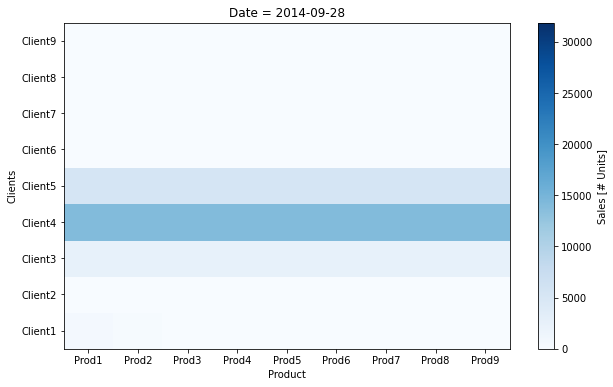

In [ ]:
def EDA_anim2D(I_data, norm=True, smooth=False, fps = 15):
    I_data.sortby(I_data.Date)

    I_data.attrs['units'] = '# Units'
    I_data.attrs['long_name'] = "Sales"
    
    # TODO check if according to needs
    if norm:
        I_data = I_data / (I_data.sum('Product')*I_data.sum('Date')) 
        I_data.attrs['units'] = 'ratio per Client'
        I_data = I_data.fillna(0)

    # TODO implement smoothing
    if smooth:
        pass

    # TODO how to handle range while handling outliers use Q3
    sales_max = I_data.max()

    
    # Get a handle on the figure and the axes
    fig, ax = plt.subplots(figsize=(10,6))

    clients_index = range(len(I_data.Clients))
    product_index = range(len(I_data.Product))
    I_data_hist = I_data.assign_coords(Clients_index=('Clients', clients_index), Product_index=('Product', product_index))
    cax = I_data_hist.isel(Date=0).9(x='Product_index', y='Clients_index',vmin=0, vmax=sales_max, cmap='Blues')

    plt.xlabel('Product')
    plt.ylabel('Clients')
    plt.xticks(product_index, I_data.Product.values)
    plt.yticks(clients_index, I_data.Clients.values)

    digits = len(str(len(I_data.Date)))

    def animate(frame):
        cax.set_array(I_data.isel(Date=frame).values.flatten())
        ax.set_title("Date = " + str(I_data.coords['Date'].values[frame])[:10])
        plt.savefig(f'Python_Animation_{frame:0{digits}}.png')

    ani = animation.FuncAnimation(
        fig,
        animate,
        frames=len(I_data.Date),
        interval=1000/fps
    )


    ani.save('Python_Animation.gif', writer='pillow', fps=fps)
    return fig, ax, ani

Fig, ax, ani = EDA_anim2D(I_data , norm=False)

In [ ]:
HTML(ani.to_jshtml())

<Figure size 432x288 with 0 Axes>

In [ ]:
files.download('Python_Animation_232.png')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

TASK 2

Objective is for exploratory analysis with an automated animation of all the data.

Same as TASK 1. But now output is different

>>	Fig, ax = EDA_animInter2DI (I_data)


OUTPUT:
Fig -= python handle for the figure
Ax = python handle of the figure axes
*png = all static shots in png format for each timestep (or maybe best to create png for every 100 timesteps)



Use bokeh and holoviews libraries to make it interactie
-	So that you can view specifics when hovering a cell

Dev file from notebook

Use these for inspiration:
1.	https://nbviewer.jupyter.org/gist/benbovy/e9d4f3d3be076de24b8842dae109d6e7 (precise walk though of Xarray with Bokeh)
2.	https://github.com/pydata/xarray/issues/2030 (last comment in 2019 suggests fps can be changed with holoview)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
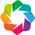

In [ ]:
hv.extension('bokeh')

In [ ]:
%%output holomap='scrubber'
%%opts Image plot[colorbar=True]
%%opts Image [width=500, height=500]

def EDA_animInter2DI (I_data):
    I_data.name = 'Sales'
    I_data['Clients'] = range(len(I_data.Clients))
    I_data['Product'] = range(len(I_data.Product))
    hv_ds = hv.Dataset(I_data)
    hv_ds
    return hv_ds.to(hv.Image, ['Product', 'Clients'])

hv_image = EDA_animInter2DI (I_data)

In [ ]:
hv.extension('bokeh')
hv_image

TASK 3

Objective is for exploratory analysis with an automated animation of all the data.

Same as TASK 1. But now output is a 3D surface map 

CREATE the def below:

>>	Fig, ax = EDA_anim_surf3D (I_data)

I_data = input variable – dataarray - in Xarray format. It is a 3 D data cube with dimensions Time, client, product.





Use these for inspiration:

1.	https://pythonmatplotlibtips.blogspot.com/2018/11/animation-3d-surface-plot-funcanimation-matplotlib.html
2.	https://nordicesmhub.github.io/deep_python/14-publish/index.html (move towards bottom of page for 3D stuff. Using more complex k3D and plotly libraries for interactivity)

In [ ]:
 def EDA_anim_surf3D(I_data, fps=15):
    fps=15
    I_data.sortby(I_data.Date)

    I_data.attrs['units'] = '# Units'
    I_data.attrs['long_name'] = "Sales"

    sales_max = float(I_data.max())

    # Get a handle on the figure and the axes
    fig = plt.figure(figsize=(10,6))
    ax = fig.add_subplot(111, projection='3d')
    # ax.set_zlim(0,sales_max)
    product_index, clients_index = np.meshgrid(range(len(I_data.Product)), range(len(I_data.Clients)))

    # I_data_hist = I_data.assign_coords(Clients_index=('Clients', clients_index), Product_index=('Product', product_index))
    data = I_data.values
    bottom = np.zeros_like(data[:,0,:].ravel())
    ax.bar3d(clients_index.ravel()-0.5,product_index.ravel()-0.5, bottom, dx=1, dy=1, dz=data[:,0,:].ravel(), zsort='max')

    plt.xlabel('Clients')
    plt.ylabel('Product')
    plt.yticks(product_index[0], I_data.Product.values)
    plt.xticks(clients_index[:,0], I_data.Clients.values)

    digits = len(str(len(I_data.Date)))

    def animate(frame):
        ax.collections.pop()
        ax.bar3d(clients_index.ravel()-0.5,product_index.ravel()-0.5, bottom, dx=1, dy=1, dz=data[:,frame,:].ravel(), zsort='max')
        ax.set_title("Date = " + str(I_data.coords['Date'].values[frame])[:10])
        # plt.savefig(f'Python_Animation_{frame:0{digits}}.png')

    ani = animation.FuncAnimation(
        fig,
        animate,
        frames=len(I_data.Date),
        interval=1000/fps
    )

    ani.save('Python_Animation.gif', writer='pillow', fps=fps)
    return fig, ax, ani

fig, ax, ani = EDA_anim_surf3D(I_data)

In [ ]:
I_data.values

In [ ]:
HTML(ani.to_jshtml())

Animation size has reached 20992945 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


# Section II
Data Visualizations when the Client data is provided in csv (converted from database, Hadoop, excel, raw text files)

**3D Visualization of Time Series Plot**

In [ ]:

import matplotlib.pyplot as plt
import pandas as pd

In [ ]:

df = pd.read_csv('SalesData.csv')
df.head()

,Product,Date,Client,Sale
0,6,01/03/2020,4,347
1,1,02/03/2020,5,33
2,1,03/03/2020,6,191
3,2,04/03/2020,7,654
4,3,05/03/2020,1,387


A 3D Visualization gives much more better shape than a 2D graph because of data paucity and randomness

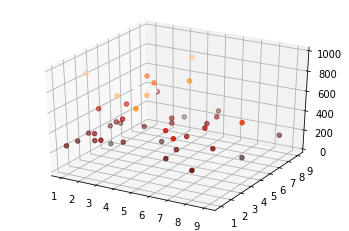

In [ ]:
def EDA_scatter3D(df):
  from mpl_toolkits import mplot3d

  # Data for three-dimensional scattered points
  ydata = df['Client']
  xdata = df['Product']
  zdata = df['Sale']
  ax = plt.axes(projection='3d', label=xdata)
  ax.scatter3D(xdata, ydata, zdata, c=zdata, cmap='gist_heat');
  return

EDA_scatter3D(df)

Plotting these two Columns rolling means and EWMA with the original data and check how does the new smoothed values look like

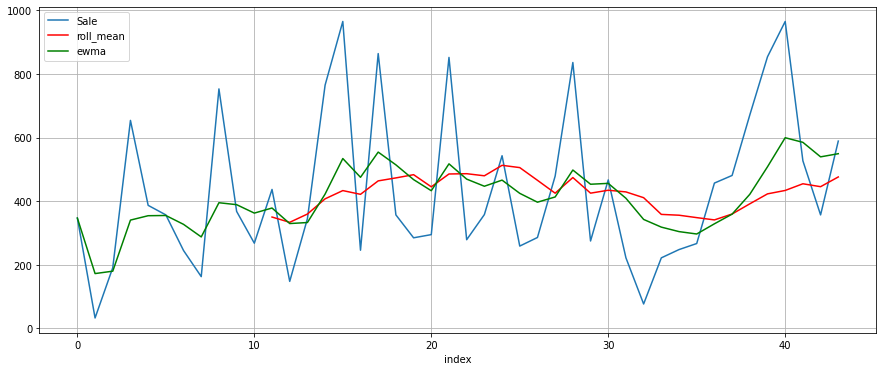

In [ ]:
def EDA_RollingnEWMA_2D(df):
  df['rolling_mean']=df['Sale'].rolling(12).mean()
  df['EWM_ALPHA_06'] = df['Sale'].ewm(alpha=0.2).mean()

  df.reset_index().plot(figsize=(15,6),kind='line',x = 'index', y = 'Sale')
  plt.grid(True)
  plt.plot(df['rolling_mean'],label='roll_mean',color='r')
  plt.plot(df['EWM_ALPHA_06'],label='ewma',color='g')
  plt.legend(loc=2)
  plt.show()
  return

EDA_RollingnEWMA_2D(df)

Box plot grouped by Date to visualize the data distribution for Sale count by Date .

/usr/local/lib/python3.6/dist-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order)


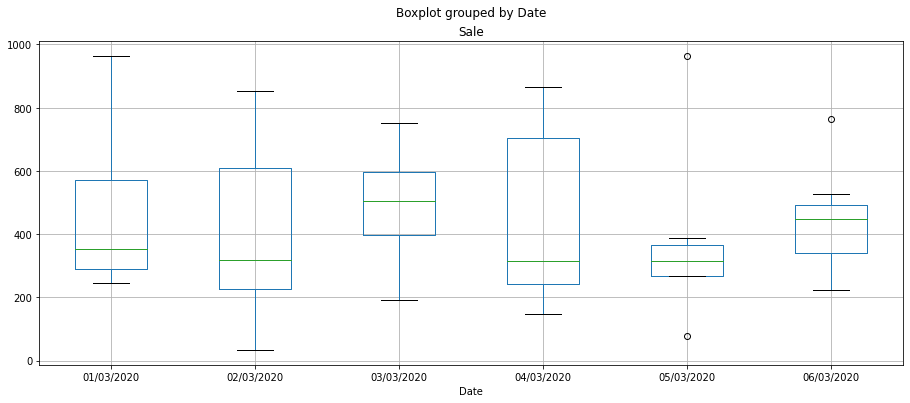

In [ ]:
def EDA_boxPlot_2D(df):
  df.boxplot(figsize=(15,6),by='Date',column='Sale')
  return

EDA_boxPlot_2D(df)

We have total 17.5 lags on X-axis and auto Correlation on the Y-axis and the line at Y=0 is the mean. Correlation values are both above & below the mean indicating positive value & negative values

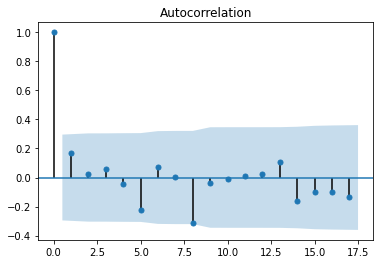

In [ ]:
def EDA_acaPlot_2D(df):
  import statsmodels.api as sm
  sm.graphics.tsa.plot_acf(df.Sale)
  return

EDA_acaPlot_2D(df)

The Partial Auto Correlation factor(PACF) is the partial correlation between the two points at a specific lag of time. plotting the partial autocorrelative functions one could determine the appropriate lags p in an AR (p) model or in an extended ARIMA (p,d,q) model

For an Autoregressive AR (p) process, the partial autocorrelation(pacf) function is defined as the value of the last coefficient(alpha-p)

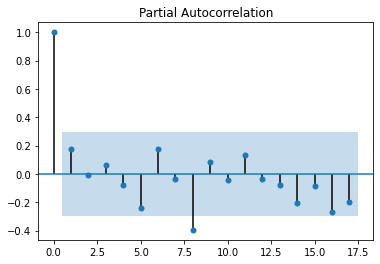

In [ ]:
def EDA_pacfPlot_2D(df):
  import statsmodels.api as sm
  sm.graphics.tsa.plot_pacf(df.Sale)
  return

EDA_pacfPlot_2D(df)

In [ ]:
import imageio

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


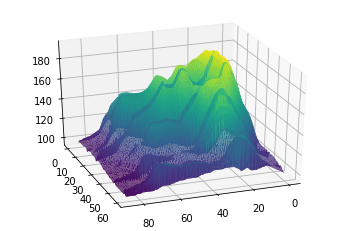

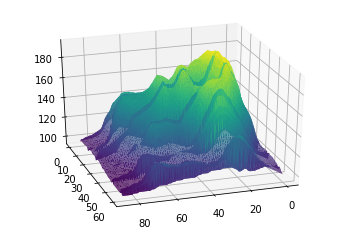

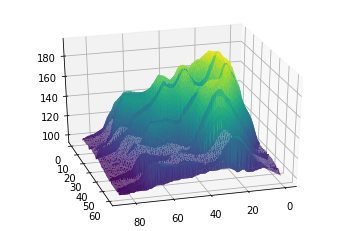

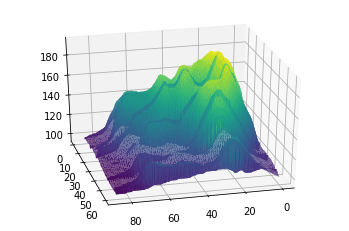

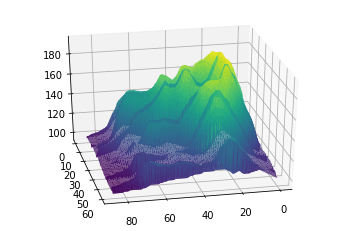

...

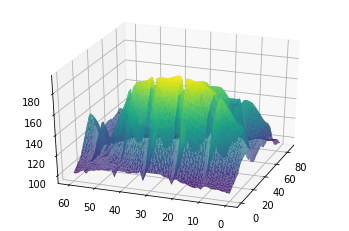

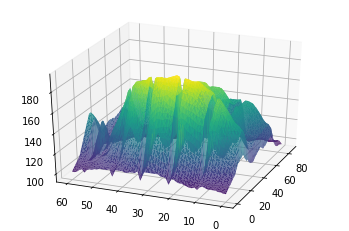

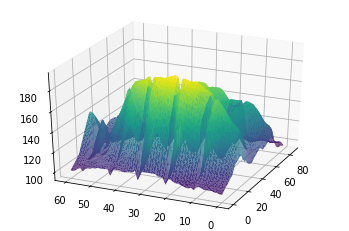

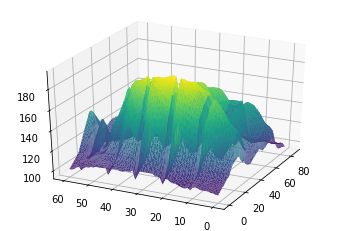

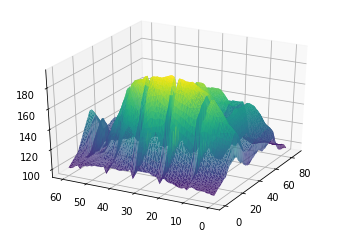

In [ ]:
# library
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
 
# Get the data (csv file is hosted on the web)

data = pd.read_csv('dailySaleData.csv')
 
# Transform it to a long format
df=data.unstack().reset_index()
df.columns=["X","Y","Z"]
 
# And transform the old column name in something numeric
df['X']=pd.Categorical(df['X'])
df['X']=df['X'].cat.codes
images = []
 
# We are going to do 20 plots, for 20 different angles
for angle in range(70,210,2):
 
    # Make the plot
  fig = plt.figure()
  ax = fig.gca(projection='3d')
  ax.plot_trisurf(df['Y'], df['X'], df['Z'], cmap=plt.cm.viridis, linewidth=0.2)
 
      # Set the angle of the camera
  ax.view_init(30,angle)
 
      # Save it
  filename='Volcano_step'+str(angle)+'.png'
  plt.savefig(filename, dpi=96)
  plt.gca()
  images.append(imageio.imread(filename))
      #Then use image magic to transform all the png files into an GIF file.

# Then use image magick (this is bash, not python)
#convert -delay 50 Volcano*.png animated_volcano.gif



    
imageio.mimsave('movie.gif', images)